In [1]:
%run ../scripts/notebook_settings_lean.py
from glob import glob
import os
import zarr
import allel

In [2]:
zarr_chrX_dir = "/home/eriks/baboondiversity/data/PG_panu3_zarr_12_03_2021/callset.zarr/chrX"
#Opening the zarr data
callset_f = zarr.open_group(zarr_chrX_dir, mode="r")
gt_zarr = allel.GenotypeArray(callset_f["calldata/GT"])
pos = allel.SortedIndex(callset_f["variants/POS"][:])

In [3]:
hap_starter = pd.read_csv("../data/haploid_metadata.txt", sep =" ")
meta_data_samples_sci = pd.read_csv("../data/Papio_metadata_with_clustering_sci.txt", sep =" ")
meta_data_samples = pd.read_csv("../data/Papio_metadata_with_clustering.txt", sep =" ")

#Generate a mapping between metadata and callset - repeat for chrX females to be sure of no errors.

ID_to_callset_f = dict(zip(callset_f["samples"][:], range(len(callset_f["samples"][:]))))
meta_data_samples_f = meta_data_samples_sci.loc[meta_data_samples_sci.PGDP_ID.isin(callset_f["samples"][:])].copy()
meta_data_samples_f["callset_index"] = meta_data_samples_f.PGDP_ID.map(ID_to_callset_f)

Automated scan approach

In [194]:
def ldblock_identification(gn, pos, min_block=10, window_size=300, retry_rule=0.8, extend_rule=0.75):
    ###
    # Inputs required are the gn (allele counts) and the associated positions.
    # They need to be equal length.
    # Optional parameters are minimum block size (int), window sizes to calculate (int),
    # and two stopping rules (floats between 0 and 1)
    # The retry rule stops the block agglomeration immediately if the block has low average LD.
    # The extend rule extends the overall block size if average LD added is above the threshold.
    
    start_pos, end_pos, variant_counts, ld_median, ld_mean = [], [], [], [], []
    start_i_l, end_i_l = [], []
    start_i = 0
    max_i = len(pos)
    c = 0
    while start_i < max_i-min_block-1:
        if start_i % 10000 == 0:
            print(start_i/max_i)
        gn_subset = gn[start_i:start_i+min_block]
        LD_array = allel.rogers_huff_r(gn_subset) ** 2
        interval_i = min_block
        if pd.Series(LD_array).notna().sum() > len(LD_array)//2:
            best_ld = pd.Series(LD_array).median()
            avg = pd.Series(LD_array).mean()
            start_ld = pd.Series(LD_array[:3]).mean()
            best_interval = interval_i
        else:
            start_i += 1
            continue
        if avg < retry_rule or best_ld < retry_rule or start_ld < retry_rule:
            start_i += 1
            continue
        max_j = min(window_size-min_block, max_i-start_i-min_block)
        for j in range(1, max_j):
            gn_subset = gn[start_i:start_i+j+min_block]
            LD_array = allel.rogers_huff_r(gn_subset) ** 2
            LD_array_add = allel.rogers_huff_r(gn_subset[j-2:]) ** 2
            median_ld = pd.Series(LD_array).median()
            avg_ld = pd.Series(LD_array).mean()
            add_ld = pd.Series(LD_array_add).mean()
            # print(add_ld, median_ld, start_i, interval_i)
            interval_i += 1
            if add_ld >= extend_rule and avg_ld >= extend_rule:
                best_ld, avg, best_interval = median_ld, avg_ld, interval_i
            if interval_i > best_interval+3 or j == max_j-1:
                # print("Stop at ", interval_i, add_ld, median_ld)
                # print("Stopped, length {}".format(best_interval))
                start_pos.append(pos[start_i])
                end_pos.append(pos[start_i+best_interval])
                variant_counts.append(best_interval)
                ld_median.append(best_ld)
                ld_mean.append(avg)
                start_i_l.append(start_i)
                end_i_l.append(start_i+best_interval)
                start_i += best_interval
                break
    return pd.DataFrame({"block_starts": start_pos, "block_ends": end_pos,
                         "interval_variants": variant_counts, "median_LD": ld_median, "average_LD": ld_mean,
                         "start_i": start_i_l, "end_i": end_i_l})

In [222]:
def ldblock_between_ld(df, gn, pos, ld_range=1000):
    matrix = np.zeros((len(df), ld_range))
    for i, row in df.iterrows():
        if i % 500 == 0:
            print(i/len(df))
        gn1 = gn[int(row.start_i):int(row.end_i)]
        max_range = min(len(df)-i, ld_range)
        for z in range(1, max_range):
            gn2 = gn[int(df.iloc[i+z].start_i):int(df.iloc[i+z].end_i)]
            LD_array = allel.rogers_huff_r_between(gn1, gn2) ** 2
            # print(LD_array)
            med_ld = pd.Series(LD_array.flatten()).median()
            matrix[i][z-1] = med_ld
    return matrix

In [269]:
def ld_runs(matrix, df, pos_reg, min_run=3):
    starts = df.start_i
    ends = df.end_i
    run_starts, run_ends, originator, start_i, end_i, orig_i, run_size_l, end_look = [], [], [], [], [], [], [], []
    for i in range(len(matrix)):
        s_array = matrix[i]
        bool_runs = (s_array[1:] >= s_array[:-1]) & (0.4 > s_array[:3].max())
        run_size = 0
        for j in range(3, len(bool_runs)):
            b = bool_runs[j]
            if b == False and run_size < min_run or i+j >= len(matrix):
                run_size = 0
            elif b == True and j+1 != len(bool_runs):
                run_size += 1
            elif run_size >= min_run:
                run_starts.append(starts[i+j-run_size])
                run_ends.append(ends[i+j+1])
                originator.append(starts[i])
                orig_i.append(i)
                run_size_l.append(run_size)
                run_size = 0
    return pd.DataFrame({"originator": originator, "run_starts": run_starts, "run_ends": run_ends,
                         "run_size": run_size_l, "orig_block": orig_i})

In [90]:
def plot_ld(gn, title, colorbar=True, ax=None, imshow_kwargs=None):
    m = allel.rogers_huff_r(gn) ** 2
    # check inputs
    from allel.stats.window import windowed_statistic
    from allel.util import asarray_ndim, ensure_square
    from allel.chunked import get_blen_array
    from allel.compat import memoryview_safe
    from allel.opt.stats import gn_pairwise_corrcoef_int8, gn_pairwise2_corrcoef_int8, \
    gn_locate_unlinked_int8
    import matplotlib.pyplot as plt

    m_square = ensure_square(m)

    # blank out lower triangle and flip up/down
    m_square = np.tril(m_square)[::-1, :]

    # set up axes
    if ax is None:
        # make a square figure with enough pixels to represent each variant
        x = m_square.shape[0] / plt.rcParams['figure.dpi']
        x = max(x, plt.rcParams['figure.figsize'][0])
        fig, ax = plt.subplots(figsize=(x, x))
        fig.tight_layout(pad=0)

    # setup imshow arguments
    if imshow_kwargs is None:
        imshow_kwargs = dict()
    imshow_kwargs.setdefault('interpolation', 'none')
    imshow_kwargs.setdefault('cmap', 'Greys')
    imshow_kwargs.setdefault('vmin', 0)
    imshow_kwargs.setdefault('vmax', 1)

    # plot as image
    im = ax.imshow(m_square, **imshow_kwargs)

    # tidy up
    ax.set_xticks([])
    ax.set_yticks([])
    for s in 'bottom', 'right':
        ax.spines[s].set_visible(False)
    if colorbar:
        plt.gcf().colorbar(im, shrink=.5, pad=0)
    ax.set_title(title)

In [195]:
# Test run
loc_region = pos.locate_range(13000000, 13300000)
IDs = meta_data_samples_f.loc[(meta_data_samples_f.Origin == "Filoha, Ethiopia")].callset_index.values

pos = allel.SortedIndex(callset_f["variants/POS"])
gt_region = allel.GenotypeArray(gt_zarr[loc_region])
gt = gt_region.take(IDs, axis=1)
ac = gt.count_alleles()[:]
np.count_nonzero(ac.max_allele() > 1)
flt = (ac.max_allele() == 1) & (ac[:, :2].min(axis=1) > (len(IDs)*2)//4)
gf = gt.compress(flt, axis=0)
gn = gf.to_n_alt()
pos_reg = pos[loc_region].compress(flt, axis=0)
df =ldblock_identification(gn, pos_reg, min_block=7)
df

0.0


,block_starts,block_ends,interval_variants,median_LD,average_LD,start_i,end_i
0,13002912,13022026,14,1.000000,0.880952,5,19
1,13037510,13085601,63,1.000000,0.932830,34,97
2,13086802,13127483,57,1.000000,0.929796,101,158
3,13129326,13170497,15,0.714286,0.828231,159,174
4,13189914,13216019,18,1.000000,0.894875,185,203
5,13222738,13240277,12,1.000000,0.841270,205,217
6,13241124,13250215,9,1.000000,0.920635,218,227
7,13250215,13288079,11,1.000000,0.823377,227,238


In [270]:
# All Blocks, Filoha
IDs = meta_data_samples_f.loc[(meta_data_samples_f.Origin == "Filoha, Ethiopia")].callset_index.values

pos = allel.SortedIndex(callset_f["variants/POS"])
gt_region = allel.GenotypeArray(gt_zarr)
gt = gt_region.take(IDs, axis=1)
ac = gt.count_alleles()[:]
np.count_nonzero(ac.max_allele() > 1)
flt = (ac.max_allele() == 1) & (ac[:, :2].min(axis=1) > (len(IDs)*2)//4)
gf = gt.compress(flt, axis=0)
gn = gf.to_n_alt()
pos_reg = pos.compress(flt, axis=0)
df =ldblock_identification(gn, pos_reg, min_block=7)
df

0.0
0.16743967985533212
0.25115951978299816
0.33487935971066424
0.5023190395659963
0.5860388794936624
0.9209182392043267


,block_starts,block_ends,interval_variants,median_LD,average_LD,start_i,end_i
0,1913,6128,10,0.714286,0.765476,2,12
1,9602,19205,55,1.000000,0.842424,18,73
2,20074,24695,17,1.000000,0.955882,78,95
3,25981,28562,16,1.000000,0.810417,99,115
4,30709,37466,36,1.000000,0.881481,119,155
...,...,...,...,...,...,...,...
2796,142586168,142625535,7,1.000000,0.805556,119175,119182
2797,142764116,142827246,7,1.000000,0.805556,119204,119211
2798,143105528,143232741,11,1.000000,0.860185,119289,119300
2799,143406213,143644720,24,0.843750,0.795477,119318,119342


<Axes: xlabel='average_LD', ylabel='Count'>

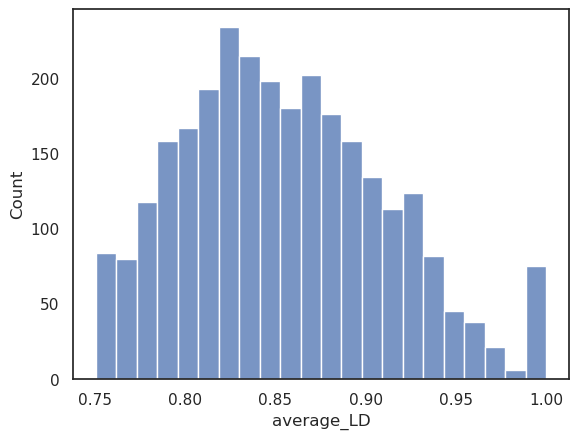

In [214]:
sns.histplot(df.average_LD)

In [223]:
ldblock_matrix = ldblock_between_ld(df, gn, pos_reg, ld_range=250)
matrix_df = pd.DataFrame(ldblock_matrix)

0.0
0.08925383791503035
0.1785076758300607
0.26776151374509105
0.3570153516601214
0.4462691895751517
0.5355230274901821
0.6247768654052124
0.7140307033202428
0.8032845412352732
0.8925383791503034
0.9817922170653338


<Axes: ylabel='150'>

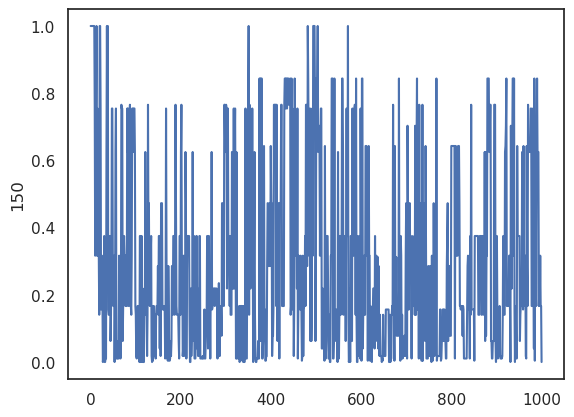

In [263]:
sns.lineplot(matrix_df.iloc[150])

In [273]:
ld_run_df = ld_runs(ldblock_matrix, df, pos_reg, min_run=6)

In [277]:
ld_run_df.loc[ld_run_df.originator == 409]

,originator,run_starts,run_ends,run_size,orig_block
0,409,2817,3105,6,11
1,409,6612,7475,14,11
2,409,11296,11561,6,11
3,409,12039,12402,6,11
4,409,16507,16811,6,11
5,409,17313,17752,6,11
6,409,19900,20132,6,11
7,409,22234,22575,8,11
8,409,40551,40745,6,11
9,409,40989,41403,6,11


In [ ]:
plot_ld(gn[409:40745], "Test")

In [276]:
df.loc[df.start_i == 409]

,block_starts,block_ends,interval_variants,median_LD,average_LD,start_i,end_i
11,105482,115099,27,0.84375,0.882966,409,436


In [257]:
# All Blocks, Filoha
IDs = meta_data_samples_f.loc[(meta_data_samples_f.Origin == "Serengeti, Tanzania")].callset_index.values

pos = allel.SortedIndex(callset_f["variants/POS"])
gt_region = allel.GenotypeArray(gt_zarr)
gt = gt_region.take(IDs, axis=1)
ac = gt.count_alleles()[:]
np.count_nonzero(ac.max_allele() > 1)
flt = (ac.max_allele() == 1) & (ac[:, :2].min(axis=1) > (len(IDs)*2)//4)
gf = gt.compress(flt, axis=0)
gn = gf.to_n_alt()
pos_reg = pos.compress(flt, axis=0)
df_serengeti = ldblock_identification(gn, pos_reg, min_block=7)
df_serengeti

0.0
0.2722298345750039
0.45371639095833977
0.5444596691500078
0.9074327819166795


,block_starts,block_ends,interval_variants,median_LD,average_LD,start_i,end_i
0,14309,17415,11,1.000000,0.840253,58,69
1,26572,29894,12,1.000000,0.848333,94,106
2,34135,37249,17,1.000000,0.866127,111,128
3,61066,73609,20,1.000000,0.857910,218,238
4,74920,80010,11,0.823529,0.773111,242,253
...,...,...,...,...,...,...,...
2353,143281686,143340225,25,1.000000,0.927259,109959,109984
2354,143375860,143419074,15,1.000000,0.893305,109998,110013
2355,143419074,143419402,13,1.000000,1.000000,110013,110026
2356,143425458,143643907,55,1.000000,0.915453,110028,110083


In [258]:
ldblock_matrix_serengeti = ldblock_between_ld(df_serengeti, gn, pos_reg, ld_range=250)
matrix_df_serengeti = pd.DataFrame(ldblock_matrix_serengeti)

0.0
0.10602205258693809
0.21204410517387617
0.31806615776081426
0.42408821034775235
0.5301102629346904
0.6361323155216285
0.7421543681085666
0.8481764206955047
0.9541984732824428


<Axes: ylabel='153'>

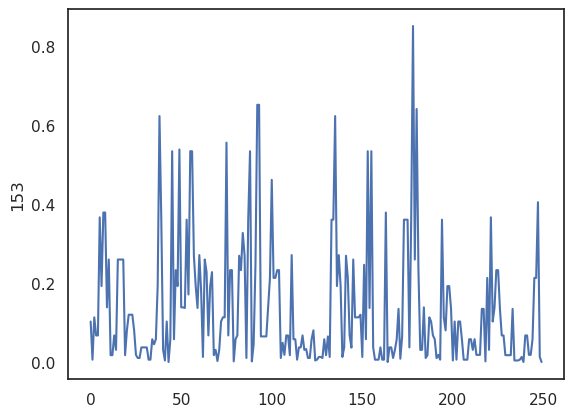

In [268]:
sns.lineplot(matrix_df_serengeti.iloc[153])

Visual investigation of found fragments.

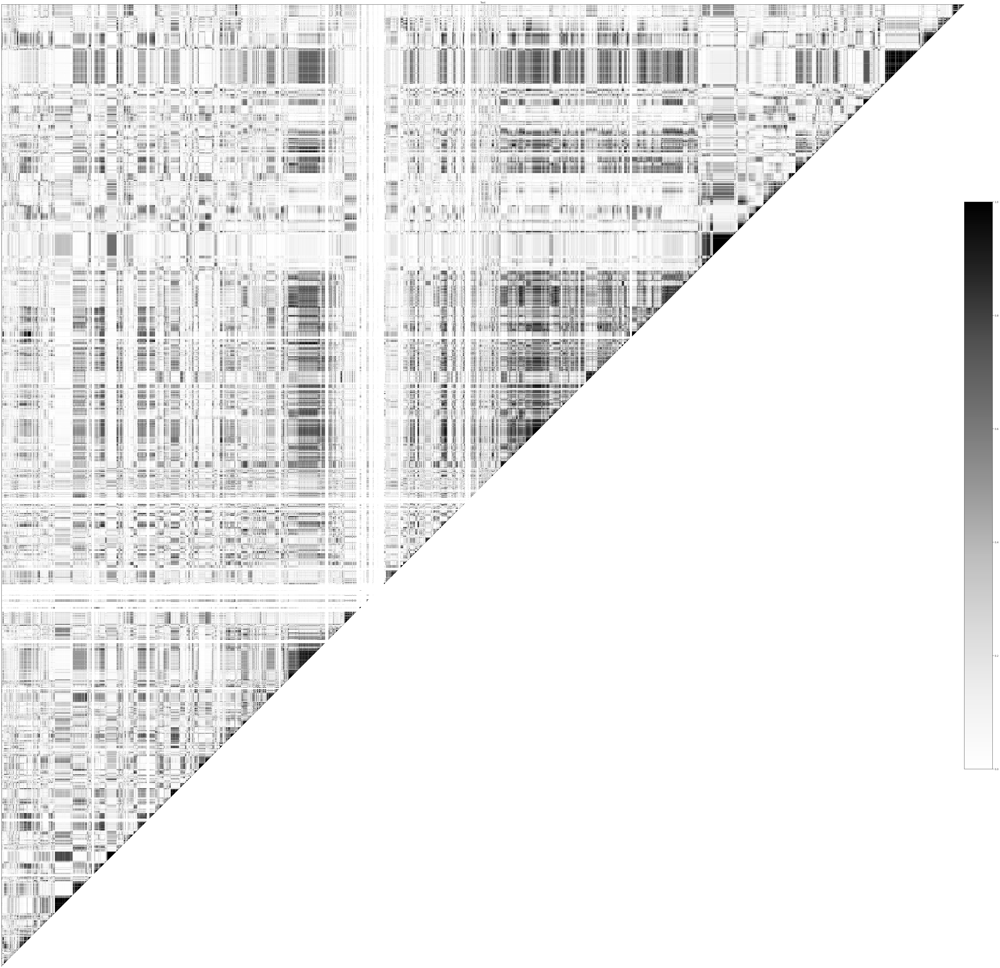

In [11]:
loc_region = pos.locate_range(9000000, 27000000)
IDs = meta_data_samples_f.loc[(meta_data_samples_f.Origin == "Gog Woreda, Gambella region, Ethiopia")].callset_index.values

pos = allel.SortedIndex(callset_f["variants/POS"])
gt_region = allel.GenotypeArray(gt_zarr[loc_region])
gt = gt_region.take(IDs, axis=1)
ac = gt.count_alleles()[:]
np.count_nonzero(ac.max_allele() > 1)
flt = (ac.max_allele() == 1) & (ac[:, :2].min(axis=1) > (len(IDs)*2)//4)
gf = gt.compress(flt, axis=0)
gn = gf.to_n_alt()
plot_ld(gn, "Test")

In [7]:
loc_region = pos.locate_range(9000000, 27000000)
IDs = meta_data_samples_f.loc[(meta_data_samples_f.Origin == "Filoha, Ethiopia")].callset_index.values

pos = allel.SortedIndex(callset_f["variants/POS"])
gt_region = allel.GenotypeArray(gt_zarr[loc_region])
gt = gt_region.take(IDs, axis=1)
ac = gt.count_alleles()[:]
np.count_nonzero(ac.max_allele() > 1)
flt = (ac.max_allele() == 1) & (ac[:, :2].min(axis=1) > (len(IDs)*2)//4)
gf = gt.compress(flt, axis=0)
gn = gf.to_n_alt()
plot_ld(gn, "Reg1")

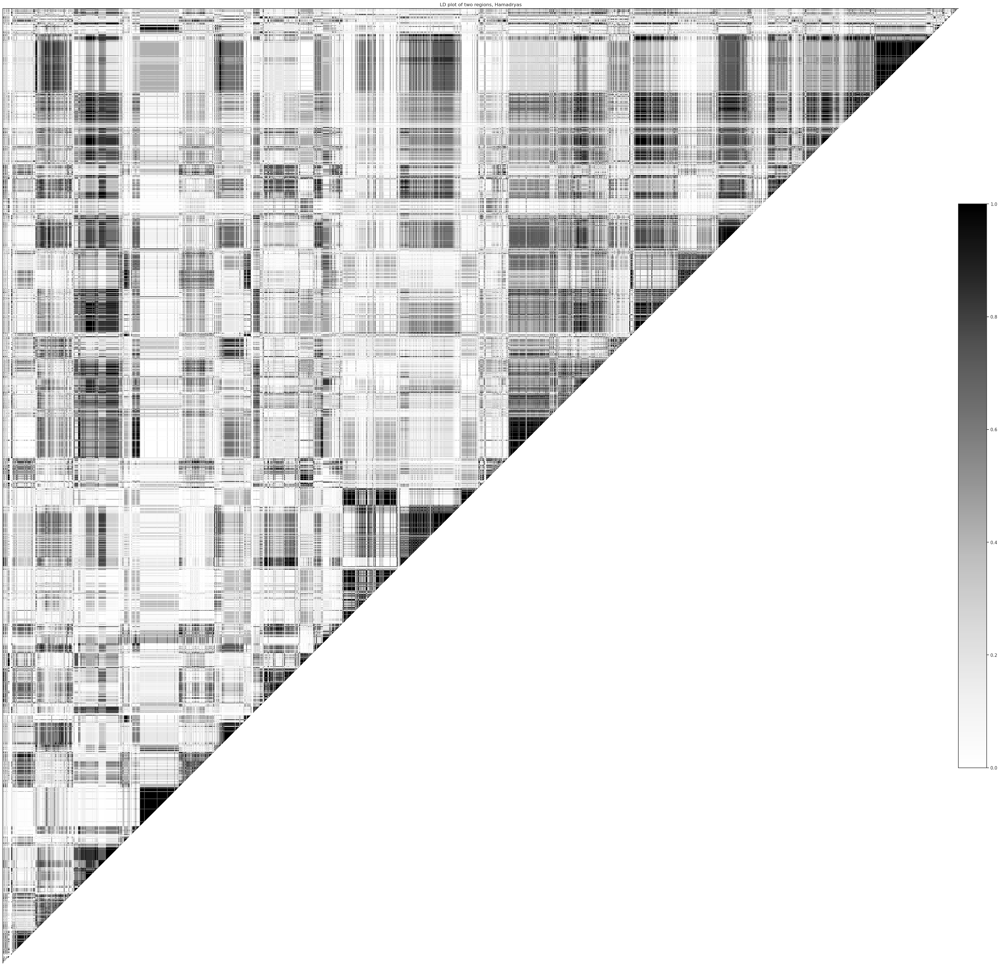

In [8]:
loc_region = pos.locate_ranges([9000000, 24000000], [12000000, 27000000])
IDs = meta_data_samples_f.loc[(meta_data_samples_f.Origin == "Filoha, Ethiopia")].callset_index.values

pos = allel.SortedIndex(callset_f["variants/POS"])
gt_region = allel.GenotypeArray(gt_zarr[loc_region])
gt = gt_region.take(IDs, axis=1)
ac = gt.count_alleles()[:]
np.count_nonzero(ac.max_allele() > 1)
flt = (ac.max_allele() == 1) & (ac[:, :2].min(axis=1) > (len(IDs)*2)//4)
gf = gt.compress(flt, axis=0)
gn = gf.to_n_alt()
plot_ld(gn, "LD plot of two regions, Hamadryas")

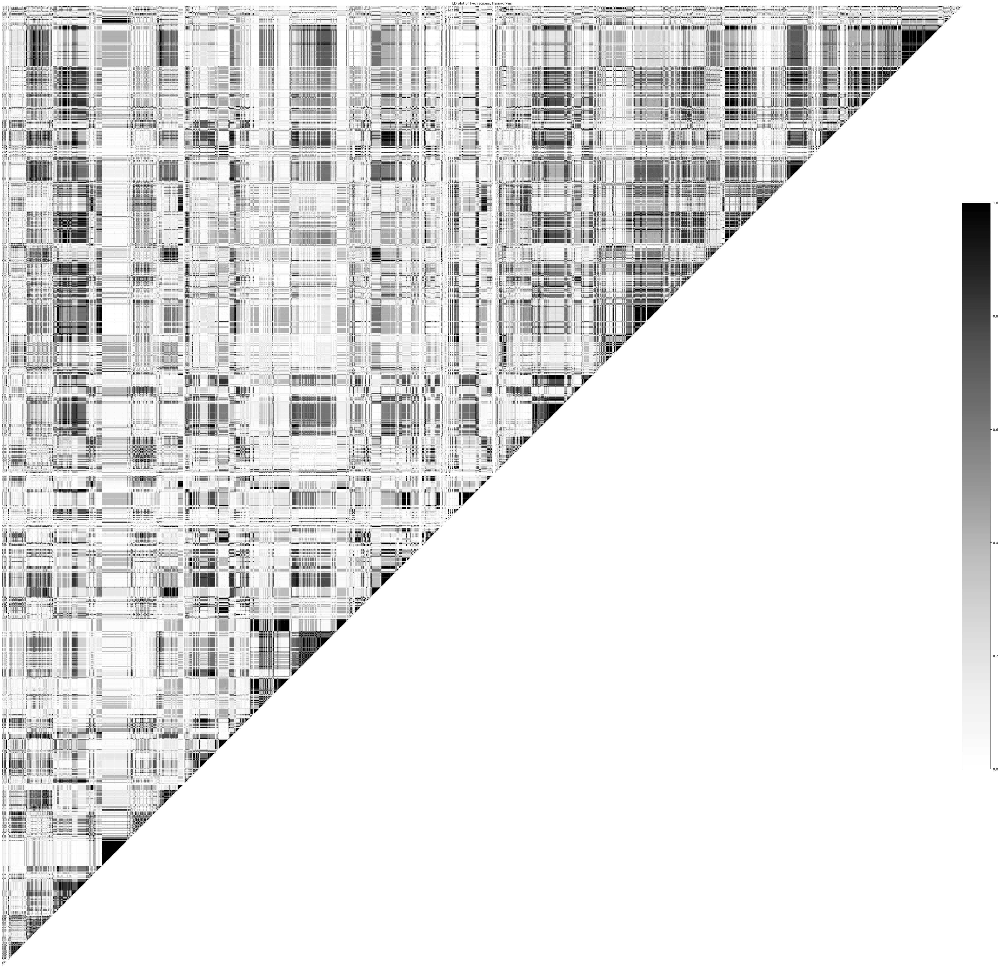

In [9]:
loc_region = pos.locate_ranges([9000000, 20000000], [12000000, 27000000])
IDs = meta_data_samples_f.loc[(meta_data_samples_f.Origin == "Filoha, Ethiopia")].callset_index.values

pos = allel.SortedIndex(callset_f["variants/POS"])
gt_region = allel.GenotypeArray(gt_zarr[loc_region])
gt = gt_region.take(IDs, axis=1)
ac = gt.count_alleles()[:]
np.count_nonzero(ac.max_allele() > 1)
flt = (ac.max_allele() == 1) & (ac[:, :2].min(axis=1) > (len(IDs)*2)//4)
gf = gt.compress(flt, axis=0)
gn = gf.to_n_alt()
plot_ld(gn, "LD plot of two regions, Hamadryas")

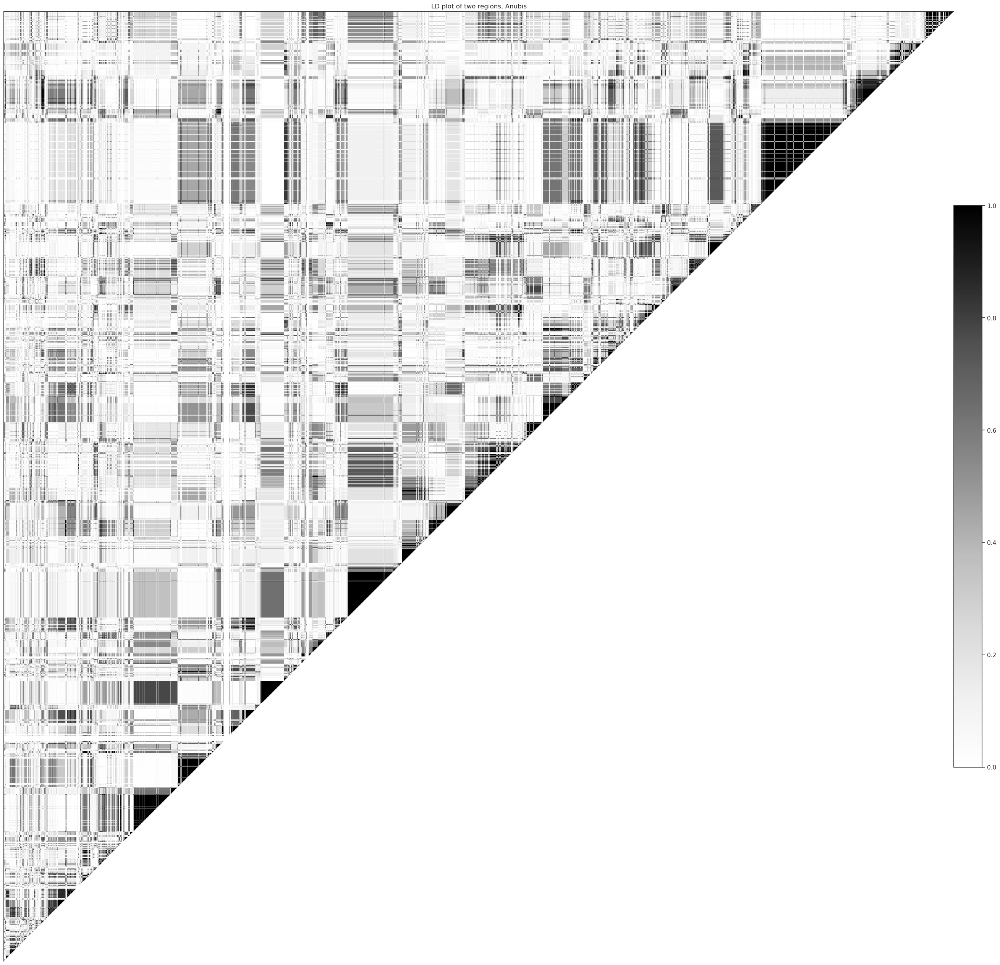

In [10]:
loc_region = pos.locate_ranges([9000000, 24000000], [12000000, 27000000])
IDs = meta_data_samples_f.loc[(meta_data_samples_f.Origin == "Gog Woreda, Gambella region, Ethiopia")].callset_index.values

pos = allel.SortedIndex(callset_f["variants/POS"])
gt_region = allel.GenotypeArray(gt_zarr[loc_region])
gt = gt_region.take(IDs, axis=1)
ac = gt.count_alleles()[:]
np.count_nonzero(ac.max_allele() > 1)
flt = (ac.max_allele() == 1) & (ac[:, :2].min(axis=1) > (len(IDs)*2)//4)
gf = gt.compress(flt, axis=0)
gn = gf.to_n_alt()
plot_ld(gn, "LD plot of two regions, Anubis")